#Kowope Mart is a Nigerian-based retail company with a vision to provide quality goods, education and automobile services to its customers at affordable price and reduce if not eradicate charges on card payments and increase customer satisfaction with credit rewards that can be used within the Mall. To achieve this, the company has partnered with DSBank on co-branded credit card with additional functionality such that customers can request for loan, pay for goods even with zero-balance and then pay back within an agreed period of time. This innovative strategy has increased sales for the company. However, there has been recent cases of credit defaults and Kowope Mart will like to have a system that profiles customers who are worthy of the card with minimum if not zero risk of defaulting.

You have been employed as a Data Scientist to leverage Machine learning to predict customers who are likely to default or not.

In this study, the attempt is to solve the problem stated below:
Predict what is the likelihood that a customer will default or not.
This is a supervised classification problem  where the label is a binary variable, 0 (default), 1 (not_default). The target variable is default_status.

In [58]:
#Importing Libraries
#Importing Libraries
# importing libraries for data handling and analysis
import pandas as pd
from pandas.plotting import scatter_matrix
from pandas import ExcelWriter
from pandas import ExcelFile
from openpyxl import load_workbook
import numpy as np
from scipy.stats import norm, skew
from scipy import stats
import statsmodels.api as sm

# importing libraries for data visualisations
import seaborn as sns
from matplotlib import pyplot
import matplotlib.pyplot as plt
import matplotlib.pylab as pylab
import matplotlib
%matplotlib inline
color = sns.color_palette()
from IPython.display import display
pd.options.display.max_columns = None
# Standard plotly imports
#import plotly
#import plotly.plotly as py
import chart_studio.plotly as cs
import plotly.figure_factory as ff
import plotly.graph_objs as go
from plotly.offline import iplot, init_notebook_mode
# Using plotly + cufflinks in offline mode
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import cufflinks as cf
cf.set_config_file(offline=True)
import cufflinks
cufflinks.go_offline(connected=True)
init_notebook_mode(connected=True)

from sklearn.preprocessing import OneHotEncoder, LabelEncoder
# from imblearn.over_sampling import SMOTE  # SMOTE
# sklearn modules for ML model selection
from sklearn.model_selection import train_test_split  # import 'train_test_split'
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import ShuffleSplit
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score

# Libraries for data modelling
from sklearn import svm, tree, linear_model, neighbors
from sklearn import naive_bayes, ensemble, discriminant_analysis, gaussian_process
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from xgboost import XGBClassifier
from sklearn.ensemble import RandomForestClassifier

# Common sklearn Model Helpers
from sklearn import feature_selection
from sklearn import model_selection
from sklearn import metrics
# from sklearn.datasets import make_classification

# sklearn modules for performance metrics
from sklearn.metrics import confusion_matrix, classification_report, precision_recall_curve
from sklearn.metrics import auc, roc_auc_score, roc_curve, recall_score, log_loss
from sklearn.metrics import f1_score, accuracy_score, roc_auc_score, make_scorer
from sklearn.metrics import average_precision_score




import numpy as np
import pandas as pd
from pandas import read_csv
from numpy import nan
from sklearn import preprocessing, neighbors
from sklearn import preprocessing, svm
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_validate
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt  # To visualize
import pandas as pd  # To read data
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler
from sklearn import preprocessing
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier as rfc
from sklearn.neighbors import KNeighborsClassifier

In [59]:
#Reading file
#Importing the data
#Let's import the dataset and make of a copy of the source file for this analysis. The train dataset contains 56000 rows and 52 columns, while the test dataset consist of 24000 rows and 51 columns.
data1 = pd.read_csv('C:/Users/Hp/Desktop/DNS ML Bootcamp/Bootcamp/Train.csv') #Train dim((56000, 52))
data2 = pd.read_csv('C:/Users/Hp/Desktop/DNS ML Bootcamp/Bootcamp/Test.csv') #Test dim((24000, 51))
print("Shape of dataframe is: {}".format(data1.shape))
print("Shape of dataframe is: {}".format(data2.shape))

df1 = data1.copy()# Make a copy of the original sourcefile
df2 = data2.copy() ##Checkpoint (Saving a copy of datasets)
applic_id = df1['Applicant_ID']
applic_id.head()

Shape of dataframe is: (56000, 52)
Shape of dataframe is: (24000, 51)


0    Apcnt_1000000
1    Apcnt_1000004
2    Apcnt_1000008
3    Apcnt_1000012
4    Apcnt_1000016
Name: Applicant_ID, dtype: object

Data Description and Exploratory Visualisations
In this section, we will provide data visualizations that summarizes or extracts relevant characteristics of features in our dataset. Let's look at each column in detail, get a better understanding of the dataset, and group them together when appropriate.

Overview


In [60]:
df1.head()
df1.tail()
df1.columns

Index(['Applicant_ID', 'form_field1', 'form_field2', 'form_field3',
       'form_field4', 'form_field5', 'form_field6', 'form_field7',
       'form_field8', 'form_field9', 'form_field10', 'form_field11',
       'form_field12', 'form_field13', 'form_field14', 'form_field15',
       'form_field16', 'form_field17', 'form_field18', 'form_field19',
       'form_field20', 'form_field21', 'form_field22', 'form_field23',
       'form_field24', 'form_field25', 'form_field26', 'form_field27',
       'form_field28', 'form_field29', 'form_field30', 'form_field31',
       'form_field32', 'form_field33', 'form_field34', 'form_field35',
       'form_field36', 'form_field37', 'form_field38', 'form_field39',
       'form_field40', 'form_field41', 'form_field42', 'form_field43',
       'form_field44', 'form_field45', 'form_field46', 'form_field47',
       'form_field48', 'form_field49', 'form_field50', 'default_status'],
      dtype='object')

In [61]:
df1.columns.to_series().groupby(df1.dtypes).groups

{dtype('int64'): Index(['form_field14'], dtype='object'),
 dtype('float64'): Index(['form_field1', 'form_field2', 'form_field3', 'form_field4',
        'form_field5', 'form_field6', 'form_field7', 'form_field8',
        'form_field9', 'form_field10', 'form_field11', 'form_field12',
        'form_field13', 'form_field15', 'form_field16', 'form_field17',
        'form_field18', 'form_field19', 'form_field20', 'form_field21',
        'form_field22', 'form_field23', 'form_field24', 'form_field25',
        'form_field26', 'form_field27', 'form_field28', 'form_field29',
        'form_field30', 'form_field31', 'form_field32', 'form_field33',
        'form_field34', 'form_field35', 'form_field36', 'form_field37',
        'form_field38', 'form_field39', 'form_field40', 'form_field41',
        'form_field42', 'form_field43', 'form_field44', 'form_field45',
        'form_field46', 'form_field48', 'form_field49', 'form_field50'],
       dtype='object'),
 dtype('O'): Index(['Applicant_ID', 'form_fi

In [62]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 56000 entries, 0 to 55999
Data columns (total 52 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Applicant_ID    56000 non-null  object 
 1   form_field1     53471 non-null  float64
 2   form_field2     52156 non-null  float64
 3   form_field3     55645 non-null  float64
 4   form_field4     55645 non-null  float64
 5   form_field5     55645 non-null  float64
 6   form_field6     42640 non-null  float64
 7   form_field7     50837 non-null  float64
 8   form_field8     42640 non-null  float64
 9   form_field9     47992 non-null  float64
 10  form_field10    55645 non-null  float64
 11  form_field11    24579 non-null  float64
 12  form_field12    46105 non-null  float64
 13  form_field13    50111 non-null  float64
 14  form_field14    56000 non-null  int64  
 15  form_field15    33525 non-null  float64
 16  form_field16    42964 non-null  float64
 17  form_field17    44849 non-null 

In [63]:
#Numeric features overview
df1.describe()

,form_field1,form_field2,form_field3,form_field4,form_field5,form_field6,form_field7,form_field8,form_field9,form_field10,form_field11,form_field12,form_field13,form_field14,form_field15,form_field16,form_field17,form_field18,form_field19,form_field20,form_field21,form_field22,form_field23,form_field24,form_field25,form_field26,form_field27,form_field28,form_field29,form_field30,form_field31,form_field32,form_field33,form_field34,form_field35,form_field36,form_field37,form_field38,form_field39,form_field40,form_field41,form_field42,form_field43,form_field44,form_field45,form_field46,form_field48,form_field49,form_field50
count,53471.000000,52156.000000,55645.000000,55645.000000,55645.000000,4.264000e+04,5.083700e+04,4.264000e+04,4.799200e+04,5.564500e+04,2.457900e+04,4.610500e+04,5.011100e+04,5.600000e+04,3.352500e+04,42964.000000,44849.000000,45598.000000,55996.000000,55645.000000,40146.000000,35600.000000,27877.000000,42703.000000,50550.000000,48562.000000,46701.000000,55645.000000,55645.000000,30491.000000,16592.000000,50550.000000,54744.000000,55645.000000,32852.000000,54005.000000,50550.000000,55645.000000,51789.000000,12271.000000,17771.000000,54677.000000,55432.000000,50617.000000,24683.000000,40096.000000,3.511100e+04,55645.000000,4.494400e+04
mean,3491.795665,0.550737,1.052225,0.851979,1.956317,6.244479e+05,6.865210e+06,2.626690e+06,1.316002e+07,1.185585e+07,2.054715e+06,2.771113e+06,6.009944e+06,6.914875e+07,1.145041e+08,0.230425,0.265692,0.271832,0.948800,1.031593,86.500380,6628.316381,6452.875072,104.558516,2624.555935,10106.554899,6190.516948,17274.315141,16518.540695,5213.246663,10857.565755,938.345321,13.926583,0.230245,0.199866,12.859069,8.480435,8.601420,0.090849,147.797977,108.117363,0.368215,6.634511,0.563377,0.072520,0.095371,3.052449e+05,1.049061,6.005862e+05
std,188.462426,0.820979,2.147768,3.157692,10.512396,1.433422e+06,1.912729e+07,3.927355e+06,1.977963e+07,2.669459e+07,4.912980e+06,4.544838e+06,2.335893e+07,2.713995e+09,1.153842e+08,0.621833,0.720198,0.725434,1.736454,1.785122,53.445528,5661.059297,5739.968774,436.670719,1964.226548,8796.472481,5390.915344,26930.742020,9666.183962,3124.491488,6049.678489,1044.597044,15.208396,0.683063,0.574002,10.621984,9.328810,7.969215,0.423802,45.085889,36.765769,0.412858,6.378946,0.196973,0.291146,0.335210,1.647757e+06,1.806160,5.842405e+06
min,2990.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,5.395430e+05,0.000000,0.000000,0.000000,0.000000,0.000000,0.255000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.166600,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.021000,0.000000,0.000000,0.000000,0.048528,0.000000,0.000000,0.000000e+00,0.000000,0.000000e+00
25%,3358.000000,0.070788,0.000000,0.000000,0.000000,1.400400e+04,6.869740e+05,1.929440e+05,1.368502e+06,4.500730e+05,2.172565e+05,2.758010e+05,1.921660e+05,1.657646e+07,5.007636e+07,0.000000,0.000000,0.000000,0.000000,0.000000,40.305000,1068.667500,797.145000,14.865000,1231.500000,3375.000000,2068.000000,60.000000,9765.000000,2312.000000,6297.000000,194.000000,2.333400,0.000000,0.000000,6.000000,2.000000,4.000000,0.000000,136.191750,87.055500,0.000000,2.020000,0.411672,0.000000,0.000000,7.710079e+01,0.000000,4.560141e-02
50%,3484.000000,0.267575,0.062000,0.000000,0.000000,1.155330e+05,2.704328e+06,9.639420e+05,5.506295e+06,3.707559e+06,6.986440e+05,1.163110e+06,1.605792e+06,2.814143e+07,8.442428e+07,0.000000,0.000000,0.000000,0.000000,0.000000,89.167500,5976.225000,5548.935000,60.660000,2203.500000,8214.000000,5110.000000,486.000000,15057.000000,5658.000000,10584.000000,598.000000,7.833400,0.000000,0.000000,10.000000,6.000000,6.000000,0.000000,150.000000,118.441500,0.220000,5.050000,0.588648,0.000000,0.000000,3.181243e+02,0.000000,1.703996e-01
75%,3620.000000,0.719512,1.282000,0.000000,0.000000,5.259280e+05,6.993831e+06,3.751516e+06,1.694552

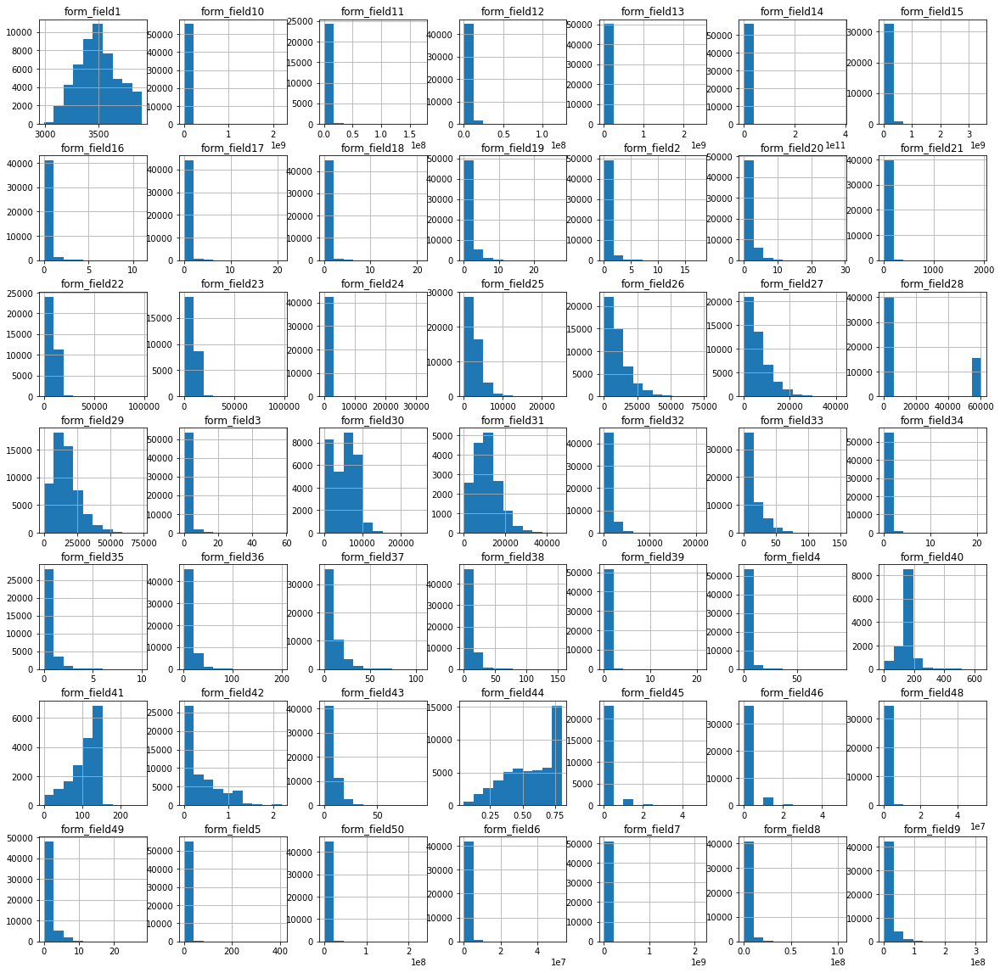

In [64]:
df1.hist(figsize=(20,20))
plt.show()

In [65]:
df1['default_status'].value_counts() # y values already given in the train
# default_status indicates if the customer did not default in paying back the loan (1, 'No') or defaulted (0, 'Yes')
df1['default_status'].value_counts() # y values already given 


no     42285
yes    13715
Name: default_status, dtype: int64

ld22     -0.238101     -0.247902     -0.266277     -0.197297   
form_field23     -0.229085     -0.239271     -0.251774     -0.189240   
form_field24     -0.006814     -0.001486     -0.105082     -0.013615   
form_field25      0.711715      0.759011      0.160480      0.655301   
form_field26      1.000000      0.912868      0.177699      0.670629   
form_field27      0.912868      1.000000      0.192783      0.615590   
form_field28      0.177699      0.192783      1.000000      0.100598   
form_field29      0.670629      0.615590      0.100598      1.000000   
form_field30      0.273786      0.268768     -0.022310      0.353347   
form_field31      0.176057      0.184899      0.001779      0.528414   
form_field32      0.689095      0.704986      0.198581      0.627171   
form_field33      0.374927      0.361847      0.144527      0.415811   
form_field34     -0.022219     -0.031595     -0.213228      0.002016   
form_field35     -0.123111     -0.126629     -0.239603     -0.092848   


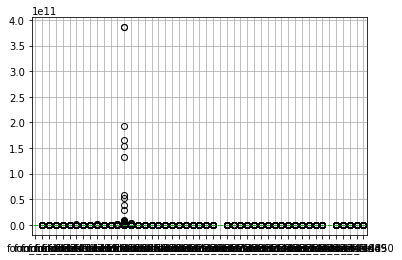

In [66]:
print(df1.corr())
print(df1.boxplot())

In [67]:
df1.isnull()
df1.isnull().sum()

Applicant_ID          0
form_field1        2529
form_field2        3844
form_field3         355
form_field4         355
form_field5         355
form_field6       13360
form_field7        5163
form_field8       13360
form_field9        8008
form_field10        355
form_field11      31421
form_field12       9895
form_field13       5889
form_field14          0
form_field15      22475
form_field16      13036
form_field17      11151
form_field18      10402
form_field19          4
form_field20        355
form_field21      15854
form_field22      20400
form_field23      28123
form_field24      13297
form_field25       5450
form_field26       7438
form_field27       9299
form_field28        355
form_field29        355
form_field30      25509
form_field31      39408
form_field32       5450
form_field33       1256
form_field34        355
form_field35      23148
form_field36       1995
form_field37       5450
form_field38        355
form_field39       4211
form_field40      43729
form_field41    

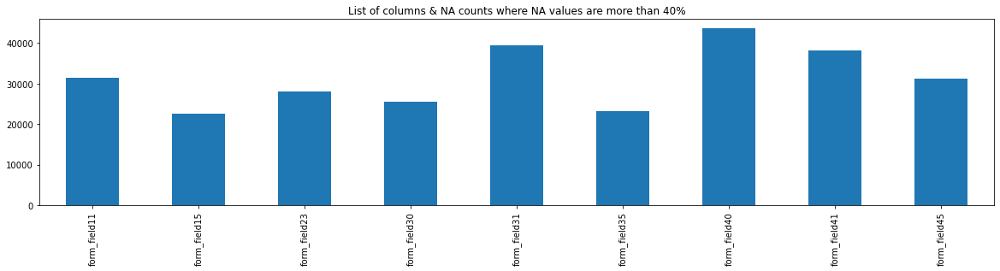

In [68]:
NA_col = df1.isnull().sum()
NA_col = NA_col[(NA_col.values) > (0.4*len(df1))]
plt.figure(figsize=(20,4))
NA_col.plot(kind='bar')
plt.title('List of columns & NA counts where NA values are more than 40%')
plt.show()
#Insights: So, it can be seen from the plot below that there are 9 columns in the dataset where all the values are NA. As we can see there are 56000 observations & 52 columns in the dataset, it will be very difficult to look at each column one by one & find the NA or missing values. So let's find out all columns where missing values are more than certain percentage, let's say 40%. We will remove those columns as it is not feasible to impute missing values for those columns. Out of 52 features we only kept 43. So I will removed about 9 features that had more than 40% missing values since it will not make any sense in further exploration. 



In [69]:
#NA_col = df2.isnull().sum()
#NA_col = NA_col[(NA_col.values) > (0.4*len(df2))]
#plt.figure(figsize=(20,4))
#NA_col.plot(kind='bar')
#plt.title('List of columns & NA counts where NA values are more than 40%')
#plt.show()


In [70]:
# This is done for train dataset as shown with the code below.
#df1.drop(['form_field11', 'form_field15', 'form_field23', 'form_field30', 'form_field31', 'form_field35', 'form_field40', #'form_field41', 'form_field45'], 1, inplace=True)

In [71]:
df1.drop(['Applicant_ID'], 1, inplace=True)

In [72]:
df2.drop(['Applicant_ID'], 1, inplace=True)

In [73]:
df1.head()

,form_field1,form_field2,form_field3,form_field4,form_field5,form_field6,form_field7,form_field8,form_field9,form_field10,form_field11,form_field12,form_field13,form_field14,form_field15,form_field16,form_field17,form_field18,form_field19,form_field20,form_field21,form_field22,form_field23,form_field24,form_field25,form_field26,form_field27,form_field28,form_field29,form_field30,form_field31,form_field32,form_field33,form_field34,form_field35,form_field36,form_field37,form_field38,form_field39,form_field40,form_field41,form_field42,form_field43,form_field44,form_field45,form_field46,form_field47,form_field48,form_field49,form_field50,default_status
0,3436.0,0.28505,1.6560,0.0,0.000,0.0,10689720.0,252072.0,4272776.0,11333126.0,4397256.0,2301324.0,7875694.0,96375139,112181765.0,1.0,1.0,1.0,3.0,3.0,134.655,NaN,NaN,134.655,4000.5,17064.0,11376.0,60.0,17064.0,5962.0,NaN,1052.0,8.0000,2.0,NaN,12.0,12.0,4.0,0.0,NaN,NaN,0.392854,2.02,0.711632,0.0,0.0,charge,NaN,1.129518,0.044335,no
1,3456.0,0.67400,0.2342,0.0,0.000,0.0,898979.0,497531.0,9073814.0,2533168.0,244292.0,3982971.0,2141445.0,28141427,45169902.0,1.0,1.0,1.0,2.0,2.0,109.230,11385.24,14584.29,86.685,4161.0,13413.0,8942.0,304.0,13413.0,5780.0,NaN,2554.0,17.5000,0.0,0.0,16.0,24.0,8.0,0.0,NaN,NaN,0.314281,8.08,0.183584,NaN,0.0,charge,349.805730,1.620483,0.322436,no
2,3276.0,0.53845,3.1510,0.0,6.282,NaN,956940.0,NaN,192944.0,1079864.0,NaN,NaN,0.0,16576457,22452691.0,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN,1597.5,4746.0,3164.0,60.0,15696.0,NaN,14508.0,70.0,0.6666,0.0,NaN,12.0,0.0,6.0,0.0,149.6805,NaN,0.162965,18.18,0.791136,0.0,0.0,charge,NaN,1.513370,0.011640,yes
3,3372.0,0.17005,0.5050,0.0,0.000,192166.0,3044703.0,385499.0,3986472.0,3621979.0,NaN,771776.0,1186839.0,48187375,136297820.0,0.0,0.0,0.0,1.0,1.0,120.120,8580.00,0.00,85.800,1701.0,4014.0,2676.0,60.0,11679.0,NaN,NaN,522.0,7.8334,1.0,1.0,4.0,8.0,4.0,1.0,NaN,NaN,0.488884,2.02,0.685168,NaN,0.0,charge,89.940100,0.664452,0.082729,no
4,3370.0,0.77270,1.1010,0.0,0.000,1556.0,214728.0,214728.0,1284089.0,361770.0,396391.0,818456.0,511535.0,28141427,15292757.0,0.0,0.0,0.0,3.0,3.0,104.535,8360.19,10326.45,115.335,1551.0,3285.0,2190.0,60.0,19437.0,12958.0,5202.0,272.0,1.0000,0.0,0.0,24.0,2.0,24.0,0.0,150.0135,NaN,0.275000,12.12,0.438168,0.0,0.0,charge,97.887502,1.427891,0.045630,no


In [74]:
for column in ('form_field1', 'form_field2', 'form_field3', 'form_field4', 'form_field5', 'form_field6', 'form_field7', 'form_field8', 'form_field9', 'form_field10', 'form_field11', 'form_field12', 'form_field13', 'form_field14', 'form_field15','form_field16', 'form_field17', 'form_field18', 'form_field19', 'form_field20', 'form_field21', 'form_field22', 'form_field23', 'form_field24', 'form_field25', 'form_field26', 'form_field27', 'form_field28', 'form_field29', 'form_field30', 'form_field31', 'form_field32', 'form_field33', 'form_field34', 'form_field35', 'form_field36', 'form_field37', 'form_field38', 'form_field39', 'form_field40', 'form_field41', 'form_field42', 'form_field43', 'form_field44', 'form_field45', 'form_field46', 'form_field48', 'form_field49', 'form_field50'):
    df1[column].fillna(df1[column].mean(), inplace = True)
    df2[column].fillna(df2[column].mean(), inplace = True)

In [75]:
df1.isnull()
df1.isnull().sum()

form_field1       0
form_field2       0
form_field3       0
form_field4       0
form_field5       0
form_field6       0
form_field7       0
form_field8       0
form_field9       0
form_field10      0
form_field11      0
form_field12      0
form_field13      0
form_field14      0
form_field15      0
form_field16      0
form_field17      0
form_field18      0
form_field19      0
form_field20      0
form_field21      0
form_field22      0
form_field23      0
form_field24      0
form_field25      0
form_field26      0
form_field27      0
form_field28      0
form_field29      0
form_field30      0
form_field31      0
form_field32      0
form_field33      0
form_field34      0
form_field35      0
form_field36      0
form_field37      0
form_field38      0
form_field39      0
form_field40      0
form_field41      0
form_field42      0
form_field43      0
form_field44      0
form_field45      0
form_field46      0
form_field47      0
form_field48      0
form_field49      0
form_field50      0


In [76]:
df2.isnull()
df2.isnull().sum()

form_field1     0
form_field2     0
form_field3     0
form_field4     0
form_field5     0
form_field6     0
form_field7     0
form_field8     0
form_field9     0
form_field10    0
form_field11    0
form_field12    0
form_field13    0
form_field14    0
form_field15    0
form_field16    0
form_field17    0
form_field18    0
form_field19    0
form_field20    0
form_field21    0
form_field22    0
form_field23    0
form_field24    0
form_field25    0
form_field26    0
form_field27    0
form_field28    0
form_field29    0
form_field30    0
form_field31    0
form_field32    0
form_field33    0
form_field34    0
form_field35    0
form_field36    0
form_field37    0
form_field38    0
form_field39    0
form_field40    0
form_field41    0
form_field42    0
form_field43    0
form_field44    0
form_field45    0
form_field46    0
form_field47    0
form_field48    0
form_field49    0
form_field50    0
dtype: int64

In [77]:
df1['default_status'].iplot(kind='hist', xTitle='default_status',
                         yTitle='count', title='default_status Distribution')

In [78]:
#Correlation
#Let's take a look at some of most significant correlations. It is worth remembering that correlation coefficients only measure linear correlations.

# Find correlations with the target (default_status) and sort
df1_trans = df1.copy()
df1_trans['Target'] = df1_trans['default_status'].apply(
    lambda x: 0 if x == 'No' else 1)
df1_trans = df1_trans.drop(
    ['default_status'], axis=1)
correlations = df1_trans.corr()['Target'].sort_values()
print('Most Positive Correlations: \n', correlations.tail(5))
print('\nMost Negative Correlations: \n', correlations.head(5))

Most Positive Correlations: 
 form_field46   NaN
form_field48   NaN
form_field49   NaN
form_field50   NaN
Target         NaN
Name: Target, dtype: float64

Most Negative Correlations: 
 form_field1   NaN
form_field2   NaN
form_field3   NaN
form_field4   NaN
form_field5   NaN
Name: Target, dtype: float64


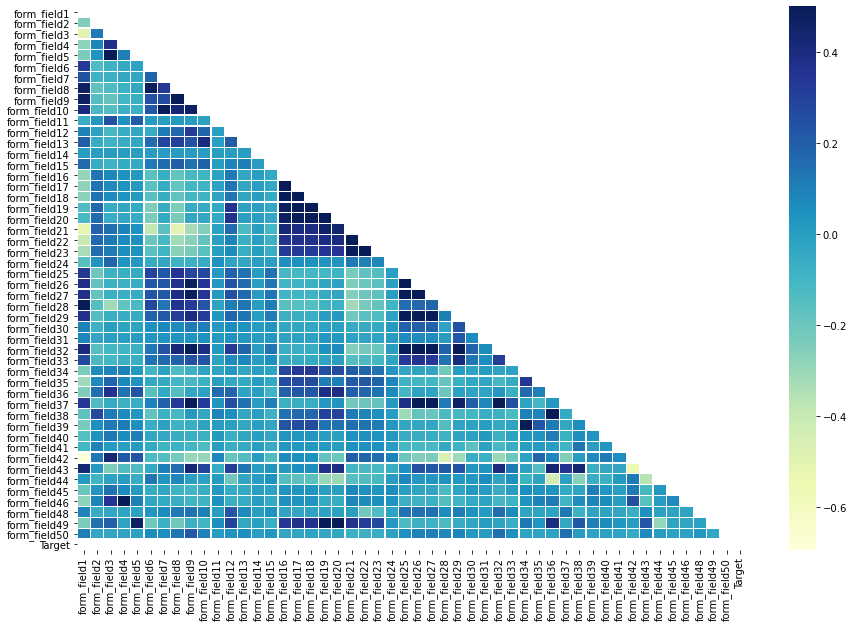

In [79]:
#Let's plot a heatmap to visualize the correlation between Attrition and these factors.

# Calculate correlations
corr = df1_trans.corr()
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask)] = True
# Heatmap
plt.figure(figsize=(15, 10))
sns.heatmap(corr,
            vmax=.5,
            mask=mask,
            # annot=True, fmt='.2f',
            linewidths=.2, cmap="YlGnBu")

In [80]:
#Pre-processing Pipeline
#In this section, we undertake data pre-processing steps to prepare the datasets for Machine Learning algorithm implementation.

#Encoding
#Machine Learning algorithms can typically only have numerical values as their predictor variables. Hence Label Encoding becomes necessary as they encode categorical labels with numerical values. To avoid introducing feature importance for categorical features with large numbers of unique values, we will use both Lable Encoding and One-Hot Encoding as shown below.

from sklearn.preprocessing import LabelEncoder, OneHotEncoder
# Create a label encoder object
le = LabelEncoder()

print(df1.shape)
df1.head()

(56000, 51)


,form_field1,form_field2,form_field3,form_field4,form_field5,form_field6,form_field7,form_field8,form_field9,form_field10,form_field11,form_field12,form_field13,form_field14,form_field15,form_field16,form_field17,form_field18,form_field19,form_field20,form_field21,form_field22,form_field23,form_field24,form_field25,form_field26,form_field27,form_field28,form_field29,form_field30,form_field31,form_field32,form_field33,form_field34,form_field35,form_field36,form_field37,form_field38,form_field39,form_field40,form_field41,form_field42,form_field43,form_field44,form_field45,form_field46,form_field47,form_field48,form_field49,form_field50,default_status
0,3436.0,0.28505,1.6560,0.0,0.000,0.000000,10689720.0,2.520720e+05,4272776.0,11333126.0,4.397256e+06,2.301324e+06,7875694.0,96375139,112181765.0,1.000000,1.000000,1.000000,3.0,3.0,134.65500,6628.316381,6452.875072,134.655000,4000.5,17064.0,11376.0,60.0,17064.0,5962.000000,10857.565755,1052.0,8.0000,2.0,0.199866,12.0,12.0,4.0,0.0,147.797977,108.117363,0.392854,2.02,0.711632,0.00000,0.0,charge,305244.932775,1.129518,0.044335,no
1,3456.0,0.67400,0.2342,0.0,0.000,0.000000,898979.0,4.975310e+05,9073814.0,2533168.0,2.442920e+05,3.982971e+06,2141445.0,28141427,45169902.0,1.000000,1.000000,1.000000,2.0,2.0,109.23000,11385.240000,14584.290000,86.685000,4161.0,13413.0,8942.0,304.0,13413.0,5780.000000,10857.565755,2554.0,17.5000,0.0,0.000000,16.0,24.0,8.0,0.0,147.797977,108.117363,0.314281,8.08,0.183584,0.07252,0.0,charge,349.805730,1.620483,0.322436,no
2,3276.0,0.53845,3.1510,0.0,6.282,624447.924437,956940.0,2.626690e+06,192944.0,1079864.0,2.054715e+06,2.771113e+06,0.0,16576457,22452691.0,0.230425,0.265692,0.271832,0.0,0.0,86.50038,6628.316381,6452.875072,104.558516,1597.5,4746.0,3164.0,60.0,15696.0,5213.246663,14508.000000,70.0,0.6666,0.0,0.199866,12.0,0.0,6.0,0.0,149.680500,108.117363,0.162965,18.18,0.791136,0.00000,0.0,charge,305244.932775,1.513370,0.011640,yes
3,3372.0,0.17005,0.5050,0.0,0.000,192166.000000,3044703.0,3.854990e+05,3986472.0,3621979.0,2.054715e+06,7.717760e+05,1186839.0,48187375,136297820.0,0.000000,0.000000,0.000000,1.0,1.0,120.12000,8580.000000,0.000000,85.800000,1701.0,4014.0,2676.0,60.0,11679.0,5213.246663,10857.565755,522.0,7.8334,1.0,1.000000,4.0,8.0,4.0,1.0,147.797977,108.117363,0.488884,2.02,0.685168,0.07252,0.0,charge,89.940100,0.664452,0.082729,no
4,3370.0,0.77270,1.1010,0.0,0.000,1556.000000,214728.0,2.147280e+05,1284089.0,361770.0,3.963910e+05,8.184560e+05,511535.0,28141427,15292757.0,0.000000,0.000000,0.000000,3.0,3.0,104.53500,8360.190000,10326.450000,115.335000,1551.0,3285.0,2190.0,60.0,19437.0,12958.000000,5202.000000,272.0,1.0000,0.0,0.000000,24.0,2.0,24.0,0.0,150.013500,108.117363,0.275000,12.12,0.438168,0.00000,0.0,charge,97.887502,1.427891,0.045630,no


In [81]:

# Label Encoding will be used for columns with 2 or less unique values
le_count = 0
for col in df1.columns[1:]:
    if df1[col].dtype == 'object':
        if len(list(df1[col].unique())) <= 2:
            le.fit(df1[col])
            df1[col] = le.transform(df1[col])
            le_count += 1
print('{} columns were label encoded.'.format(le_count))

2 columns were label encoded.


In [82]:
# Label Encoding will be used for columns with 2 or less unique values
le_count = 0
for col in df2.columns[1:]:
    if df2[col].dtype == 'object':
        if len(list(df2[col].unique())) <= 2:
            le.fit(df2[col])
            df2[col] = le.transform(df2[col])
            le_count += 1
print('{} columns were label encoded.'.format(le_count))

1 columns were label encoded.


In [83]:
# convert rest of categorical variable into dummy
df1 = pd.get_dummies(df1, drop_first=True)

In [84]:
# convert rest of categorical variable into dummy
df2 = pd.get_dummies(df2, drop_first=True)

In [85]:
print(df1.shape)
df1.head()

(56000, 51)


,form_field1,form_field2,form_field3,form_field4,form_field5,form_field6,form_field7,form_field8,form_field9,form_field10,form_field11,form_field12,form_field13,form_field14,form_field15,form_field16,form_field17,form_field18,form_field19,form_field20,form_field21,form_field22,form_field23,form_field24,form_field25,form_field26,form_field27,form_field28,form_field29,form_field30,form_field31,form_field32,form_field33,form_field34,form_field35,form_field36,form_field37,form_field38,form_field39,form_field40,form_field41,form_field42,form_field43,form_field44,form_field45,form_field46,form_field47,form_field48,form_field49,form_field50,default_status
0,3436.0,0.28505,1.6560,0.0,0.000,0.000000,10689720.0,2.520720e+05,4272776.0,11333126.0,4.397256e+06,2.301324e+06,7875694.0,96375139,112181765.0,1.000000,1.000000,1.000000,3.0,3.0,134.65500,6628.316381,6452.875072,134.655000,4000.5,17064.0,11376.0,60.0,17064.0,5962.000000,10857.565755,1052.0,8.0000,2.0,0.199866,12.0,12.0,4.0,0.0,147.797977,108.117363,0.392854,2.02,0.711632,0.00000,0.0,0,305244.932775,1.129518,0.044335,0
1,3456.0,0.67400,0.2342,0.0,0.000,0.000000,898979.0,4.975310e+05,9073814.0,2533168.0,2.442920e+05,3.982971e+06,2141445.0,28141427,45169902.0,1.000000,1.000000,1.000000,2.0,2.0,109.23000,11385.240000,14584.290000,86.685000,4161.0,13413.0,8942.0,304.0,13413.0,5780.000000,10857.565755,2554.0,17.5000,0.0,0.000000,16.0,24.0,8.0,0.0,147.797977,108.117363,0.314281,8.08,0.183584,0.07252,0.0,0,349.805730,1.620483,0.322436,0
2,3276.0,0.53845,3.1510,0.0,6.282,624447.924437,956940.0,2.626690e+06,192944.0,1079864.0,2.054715e+06,2.771113e+06,0.0,16576457,22452691.0,0.230425,0.265692,0.271832,0.0,0.0,86.50038,6628.316381,6452.875072,104.558516,1597.5,4746.0,3164.0,60.0,15696.0,5213.246663,14508.000000,70.0,0.6666,0.0,0.199866,12.0,0.0,6.0,0.0,149.680500,108.117363,0.162965,18.18,0.791136,0.00000,0.0,0,305244.932775,1.513370,0.011640,1
3,3372.0,0.17005,0.5050,0.0,0.000,192166.000000,3044703.0,3.854990e+05,3986472.0,3621979.0,2.054715e+06,7.717760e+05,1186839.0,48187375,136297820.0,0.000000,0.000000,0.000000,1.0,1.0,120.12000,8580.000000,0.000000,85.800000,1701.0,4014.0,2676.0,60.0,11679.0,5213.246663,10857.565755,522.0,7.8334,1.0,1.000000,4.0,8.0,4.0,1.0,147.797977,108.117363,0.488884,2.02,0.685168,0.07252,0.0,0,89.940100,0.664452,0.082729,0
4,3370.0,0.77270,1.1010,0.0,0.000,1556.000000,214728.0,2.147280e+05,1284089.0,361770.0,3.963910e+05,8.184560e+05,511535.0,28141427,15292757.0,0.000000,0.000000,0.000000,3.0,3.0,104.53500,8360.190000,10326.450000,115.335000,1551.0,3285.0,2190.0,60.0,19437.0,12958.000000,5202.000000,272.0,1.0000,0.0,0.000000,24.0,2.0,24.0,0.0,150.013500,108.117363,0.275000,12.12,0.438168,0.00000,0.0,0,97.887502,1.427891,0.045630,0


In [86]:
print(df2.shape)
df2.head()

(24000, 50)


,form_field1,form_field2,form_field3,form_field4,form_field5,form_field6,form_field7,form_field8,form_field9,form_field10,form_field11,form_field12,form_field13,form_field14,form_field15,form_field16,form_field17,form_field18,form_field19,form_field20,form_field21,form_field22,form_field23,form_field24,form_field25,form_field26,form_field27,form_field28,form_field29,form_field30,form_field31,form_field32,form_field33,form_field34,form_field35,form_field36,form_field37,form_field38,form_field39,form_field40,form_field41,form_field42,form_field43,form_field44,form_field45,form_field46,form_field47,form_field48,form_field49,form_field50
0,3236.000000,0.34875,10.2006,0.0000,0.0,418564.00000,4.185640e+05,4.185640e+05,5.407100e+05,0.0,1649749.0,5.446000e+03,0.000000e+00,48187375,1.146861e+08,0.000000,0.000000,0.000000,0.0,0.0,87.11408,6653.189477,6473.026142,105.934375,1086.00000,6204.000000,2676.000000,60.0,14691.0,9794.000000,10934.016134,238.000000,1.8334,0.0,0.194071,22.0,2.000000,14.0,0.000000,147.62328,108.209648,0.825000,1.01,0.800000,0.066526,0.000000,0,301544.001781,0.000000,0.011221
1,3284.000000,1.27360,2.9606,9.0198,0.0,0.00000,9.858816e+06,4.901400e+04,1.510098e+06,18308285.0,622789.0,1.025793e+06,1.396510e+06,34694910,8.747949e+07,1.000000,1.000000,1.000000,2.0,2.0,142.56000,6653.189477,6473.026142,570.585000,3082.50000,10221.000000,6814.000000,60.0,11955.0,3528.000000,10934.016134,1216.000000,19.5000,3.0,0.194071,30.0,18.000000,14.0,2.000000,147.62328,18.841500,0.507694,4.04,0.623248,1.000000,0.000000,1,301544.001781,0.504974,0.043525
2,3492.284404,0.27505,0.0600,0.0000,0.0,626303.61796,6.797033e+06,2.654142e+06,1.350593e+07,0.0,118256.0,2.772047e+06,5.984000e+06,21973443,1.141483e+08,0.234265,0.267651,0.272477,0.0,0.0,87.11408,6653.189477,6473.026142,105.934375,2626.35803,10109.255617,6199.305027,852.0,4836.0,5248.247174,10934.016134,946.711921,7.8334,0.0,0.194071,2.0,8.554544,0.0,0.090749,147.62328,108.209648,0.369684,0.00,0.566219,0.066526,0.097926,0,301544.001781,0.000000,674984.349339
3,3232.000000,0.28505,2.8032,0.0000,0.0,0.00000,4.738020e+05,4.738020e+05,1.724437e+06,493641.0,1391064.0,1.176725e+06,1.220293e+06,16576457,1.141483e+08,2.000000,2.000000,2.000000,3.0,3.0,109.00500,13050.000000,6473.026142,109.005000,1414.50000,4197.000000,2798.000000,60.0,14964.0,5248.247174,10934.016134,248.000000,9.0000,1.0,1.000000,36.0,0.000000,26.0,0.000000,147.62328,108.209648,0.916663,2.02,0.464224,0.066526,0.097926,0,90.163742,0.788809,0.104029
4,3466.000000,2.09545,0.8318,2.5182,0.0,19839.00000,1.150662e+06,1.150662e+06,7.860523e+06,5752921.0,271133.0,6.130640e+05,4.779643e+06,48187375,7.204980e+07,0.000000,0.000000,0.000000,3.0,3.0,139.06500,469.290000,469.290000,15.180000,2724.00000,9855.000000,6570.000000,182.0,11679.0,5900.000000,10934.016134,2388.000000,16.6666,1.0,0.000000,24.0,28.000000,20.0,0.000000,147.62328,108.209648,0.234047,23.23,0.726688,0.000000,0.000000,1,1303.587148,1.637733,0.163124


In [87]:
#Feature Scaling
#Feature Scaling using MinMaxScaler essentially shrinks the range such that the range is now between 0 and n. Machine Learning algorithms perform better when input numerical variables fall within a similar scale. In this case, we are scaling between 0 and 5.

# import MinMaxScaler
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler(feature_range=(0, 5))
df_col = list(df1.columns)
df_col.remove('default_status')
for col in df_col:
    df1[col] = df1[col].astype(float)
    df1[[col]] = scaler.fit_transform(df1[[col]])
df1['default_status'] = pd.to_numeric(df1['default_status'], downcast='float')
df1.head()

,form_field1,form_field2,form_field3,form_field4,form_field5,form_field6,form_field7,form_field8,form_field9,form_field10,form_field11,form_field12,form_field13,form_field14,form_field15,form_field16,form_field17,form_field18,form_field19,form_field20,form_field21,form_field22,form_field23,form_field24,form_field25,form_field26,form_field27,form_field28,form_field29,form_field30,form_field31,form_field32,form_field33,form_field34,form_field35,form_field36,form_field37,form_field38,form_field39,form_field40,form_field41,form_field42,form_field43,form_field44,form_field45,form_field46,form_field47,form_field48,form_field49,form_field50,default_status
0,2.450549,0.079114,0.144322,0.0,0.000000,0.000000,0.024759,0.012149,0.066751,0.025859,0.128768,0.092762,0.016022,0.001250,0.161539,0.454545,0.238095,0.238095,0.535714,0.517241,0.343274,0.340963,0.331938,0.021130,0.797119,1.164381,1.337661,0.004936,1.154314,1.166732,1.152975,0.246879,0.257960,0.476190,0.099933,0.252525,0.566038,0.128205,0.000000,1.144797,2.119948,0.892850,0.109890,4.412034,0.00000,0.0,0.0,0.028683,0.201700,9.606385e-10,0.0
1,2.560440,0.187066,0.020411,0.0,0.000000,0.000000,0.002082,0.023980,0.141755,0.005780,0.007154,0.160547,0.004356,0.000365,0.064577,0.454545,0.238095,0.238095,0.357143,0.344828,0.278335,0.585660,0.750221,0.013602,0.829099,0.915251,1.051456,0.025012,0.907338,1.131115,1.152975,0.599362,0.570803,0.000000,0.000000,0.353535,1.132075,0.256410,0.000000,1.144797,2.119948,0.714275,0.439560,0.898610,0.07252,0.0,0.0,0.000033,0.289372,6.986484e-09,0.0
2,1.571429,0.149444,0.274613,0.0,0.077033,0.058760,0.002216,0.126600,0.003014,0.002464,0.060170,0.111699,0.000000,0.000215,0.031707,0.104739,0.063260,0.064722,0.000000,0.000000,0.220281,0.340963,0.331938,0.016407,0.318310,0.323849,0.372043,0.004936,1.061774,1.020205,1.540618,0.016427,0.016465,0.000000,0.099933,0.252525,0.000000,0.192308,0.000000,1.159380,2.119948,0.370375,0.989011,4.941022,0.00000,0.0,0.0,0.028683,0.270245,2.522061e-10,1.0
3,2.098901,0.047197,0.044011,0.0,0.000000,0.018083,0.007052,0.018580,0.062278,0.008264,0.060170,0.031109,0.002414,0.000625,0.196433,0.000000,0.000000,0.000000,0.178571,0.172414,0.306150,0.441358,0.000000,0.013464,0.338932,0.273900,0.314661,0.004936,0.790040,1.020205,1.152975,0.122501,0.252474,0.238095,0.500000,0.050505,0.377358,0.128205,0.238095,1.144797,2.119948,1.111100,0.109890,4.235953,0.07252,0.0,0.0,0.000008,0.118652,1.792546e-09,0.0
4,2.087912,0.214460,0.095953,0.0,0.000000,0.000146,0.000497,0.010349,0.020061,0.000825,0.011608,0.032991,0.001041,0.000365,0.021347,0.000000,0.000000,0.000000,0.535714,0.517241,0.266344,0.430051,0.531196,0.018098,0.309044,0.224156,0.257514,0.004936,1.314839,2.535812,0.552405,0.063832,0.027445,0.000000,0.000000,0.555556,0.094340,0.769231,0.000000,1.161960,2.119948,0.625000,0.659341,2.592512,0.00000,0.0,0.0,0.000009,0.254981,9.886991e-10,0.0


In [88]:
print('Size of Full Encoded Dataset: {}'. format(df1.shape))

Size of Full Encoded Dataset: (56000, 51)


In [89]:
#df2.drop(['form_field11', 'form_field23', 'form_field30', 'form_field31', 'form_field35', 'form_field40', 'form_field41', #'form_field45'], 1, inplace=True) 


In [90]:
#Building Machine Learning Models
#Baseline Algorithms
#Let's first use a range of baseline algorithms (using out-of-the-box hyper-parameters) before we move on to more sophisticated solutions. The algorithms considered in this section are: Logistic Regression, Random Forest, SVM, KNN, Decision Tree Classifier, Gaussian NB.

In [91]:
#Data Labelling
y_train = df1[['default_status']] #Target Variable
         
X_train = df1.loc[:, df1.columns != 'default_status']  #Predictor variable

X_test = df2
X_train.head()
#y_test = 

,form_field1,form_field2,form_field3,form_field4,form_field5,form_field6,form_field7,form_field8,form_field9,form_field10,form_field11,form_field12,form_field13,form_field14,form_field15,form_field16,form_field17,form_field18,form_field19,form_field20,form_field21,form_field22,form_field23,form_field24,form_field25,form_field26,form_field27,form_field28,form_field29,form_field30,form_field31,form_field32,form_field33,form_field34,form_field35,form_field36,form_field37,form_field38,form_field39,form_field40,form_field41,form_field42,form_field43,form_field44,form_field45,form_field46,form_field47,form_field48,form_field49,form_field50
0,2.450549,0.079114,0.144322,0.0,0.000000,0.000000,0.024759,0.012149,0.066751,0.025859,0.128768,0.092762,0.016022,0.001250,0.161539,0.454545,0.238095,0.238095,0.535714,0.517241,0.343274,0.340963,0.331938,0.021130,0.797119,1.164381,1.337661,0.004936,1.154314,1.166732,1.152975,0.246879,0.257960,0.476190,0.099933,0.252525,0.566038,0.128205,0.000000,1.144797,2.119948,0.892850,0.109890,4.412034,0.00000,0.0,0.0,0.028683,0.201700,9.606385e-10
1,2.560440,0.187066,0.020411,0.0,0.000000,0.000000,0.002082,0.023980,0.141755,0.005780,0.007154,0.160547,0.004356,0.000365,0.064577,0.454545,0.238095,0.238095,0.357143,0.344828,0.278335,0.585660,0.750221,0.013602,0.829099,0.915251,1.051456,0.025012,0.907338,1.131115,1.152975,0.599362,0.570803,0.000000,0.000000,0.353535,1.132075,0.256410,0.000000,1.144797,2.119948,0.714275,0.439560,0.898610,0.07252,0.0,0.0,0.000033,0.289372,6.986484e-09
2,1.571429,0.149444,0.274613,0.0,0.077033,0.058760,0.002216,0.126600,0.003014,0.002464,0.060170,0.111699,0.000000,0.000215,0.031707,0.104739,0.063260,0.064722,0.000000,0.000000,0.220281,0.340963,0.331938,0.016407,0.318310,0.323849,0.372043,0.004936,1.061774,1.020205,1.540618,0.016427,0.016465,0.000000,0.099933,0.252525,0.000000,0.192308,0.000000,1.159380,2.119948,0.370375,0.989011,4.941022,0.00000,0.0,0.0,0.028683,0.270245,2.522061e-10
3,2.098901,0.047197,0.044011,0.0,0.000000,0.018083,0.007052,0.018580,0.062278,0.008264,0.060170,0.031109,0.002414,0.000625,0.196433,0.000000,0.000000,0.000000,0.178571,0.172414,0.306150,0.441358,0.000000,0.013464,0.338932,0.273900,0.314661,0.004936,0.790040,1.020205,1.152975,0.122501,0.252474,0.238095,0.500000,0.050505,0.377358,0.128205,0.238095,1.144797,2.119948,1.111100,0.109890,4.235953,0.07252,0.0,0.0,0.000008,0.118652,1.792546e-09
4,2.087912,0.214460,0.095953,0.0,0.000000,0.000146,0.000497,0.010349,0.020061,0.000825,0.011608,0.032991,0.001041,0.000365,0.021347,0.000000,0.000000,0.000000,0.535714,0.517241,0.266344,0.430051,0.531196,0.018098,0.309044,0.224156,0.257514,0.004936,1.314839,2.535812,0.552405,0.063832,0.027445,0.000000,0.000000,0.555556,0.094340,0.769231,0.000000,1.161960,2.119948,0.625000,0.659341,2.592512,0.00000,0.0,0.0,0.000009,0.254981,9.886991e-10


In [95]:
#Building models
Reg = LogisticRegression() ## Logistic Regression
Reg.fit(X_train, y_train) ##Fitting the data
Reg.score(X_train, y_train) ##Accuracy of model
y_pred_1 = Reg.predict(X_test) #Prediction

classifier = KNeighborsClassifier(n_neighbors=3) ##K Nearest Neighbors
classifier.fit(X_train, y_train) ##Fitting the data
classifier.score(X_train, y_train) ##Accuracy of model
y_pred_2 = classifier.predict(X_test) #Prediction

#rfc = rfc() ##Random forest
#rfc.fit(X_train, y_train) ##Fitting the data
#rfc.score(X_train, y_train) ##Accuracy
#y_test_3 = rfc.predict(X_test) #Prediction

#Exporting the predicted values to csv(comma separeted value)
df = pd.DataFrame(data=y_pred_1)
df.to_csv('df.csv')
##Saving the prediction
#a = pd.read_csv('PreHackthonSubmission.csv')

#output = pd.DataFrame({'Applicant_ID':a['Applicant_ID'], 'default_status': y_test_3})
#output.to_csv('my_prediction.csv', index = False)



In [155]:
#Building Machine Learning Models
#Baseline Algorithms
#Let's first use a range of baseline algorithms (using out-of-the-box hyper-parameters) before we move on to more sophisticated solutions. The algorithms considered in this section are: Logistic Regression, Random Forest, SVM, KNN, Decision Tree Classifier, Gaussian NB.

# selection of algorithms to consider and set performance measure
models = []
models.append(('Logistic Regression', LogisticRegression(solver='liblinear', random_state=7,
                                                         class_weight='balanced')))
models.append(('Random Forest', RandomForestClassifier(
    n_estimators=100, random_state=7)))
models.append(('SVM', SVC(gamma='auto', random_state=7)))
models.append(('KNN', KNeighborsClassifier()))
models.append(('Decision Tree Classifier',
               DecisionTreeClassifier(random_state=7)))
models.append(('Gaussian NB', GaussianNB()))

In [70]:
#Let's evaluate each model in turn and provide accuracy and standard deviation scores

acc_results = []
auc_results = []
names = []
# set table to table to populate with performance results
col = ['Algorithm', 'ROC AUC Mean', 'ROC AUC STD', 
       'Accuracy Mean', 'Accuracy STD']
df_results = pd.DataFrame(columns=col)
i = 0
# evaluate each model using cross-validation
for name, model in models:
    kfold = model_selection.KFold(
        n_splits=10, random_state=7)  # 10-fold cross-validation

    cv_acc_results = model_selection.cross_val_score(  # accuracy scoring
        model, X_train, y_train, cv=kfold, scoring='accuracy')

    cv_auc_results = model_selection.cross_val_score(  # roc_auc scoring
        model, X_train, y_train, cv=kfold, scoring='roc_auc')

    acc_results.append(cv_acc_results)
    auc_results.append(cv_auc_results)
    names.append(name)
    df_results.loc[i] = [name,
                         round(cv_auc_results.mean()*100, 2),
                         round(cv_auc_results.std()*100, 2),
                         round(cv_acc_results.mean()*100, 2),
                         round(cv_acc_results.std()*100, 2)
                         ]
    i += 1
df_results.sort_values(by=['ROC AUC Mean'], ascending=False)

s)
  File "C:\Users\Hp\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\naive_bayes.py", line 210, in fit
    X, y = self._validate_data(X, y)
  File "C:\Users\Hp\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py", line 432, in _validate_data
    X, y = check_X_y(X, y, **check_params)
  File "C:\Users\Hp\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\utils\validation.py", line 73, in inner_f
    return f(**kwargs)
  File "C:\Users\Hp\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\utils\validation.py", line 796, in check_X_y
    X = check_array(X, accept_sparse=accept_sparse,
  File "C:\Users\Hp\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\utils\validation.py", line 73, in inner_f
    return f(**kwargs)
  File "C:\Users\Hp\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\utils\validation.py", line 599, in check_array
    array = np.asarray(array, order=order, dtype=dtype)
  Fil

,Algorithm,ROC AUC Mean,ROC AUC STD,Accuracy Mean,Accuracy STD
0,Logistic Regression,NaN,NaN,NaN,NaN
1,Random Forest,NaN,NaN,NaN,NaN
2,SVM,NaN,NaN,NaN,NaN
3,KNN,NaN,NaN,NaN,NaN
4,Decision Tree Classifier,NaN,NaN,NaN,NaN
5,Gaussian NB,NaN,NaN,NaN,NaN


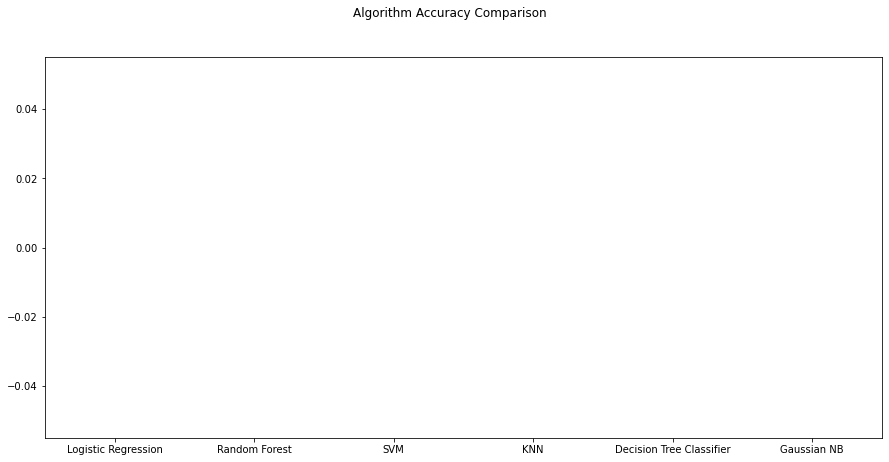

In [71]:
#Classification Accuracy is the number of correct predictions made as a ratio of all predictions made. 
#It is the most common evaluation metric for classification problems. However, it is often misused as it is only really suitable when there are an equal number of observations in each class and all predictions and prediction errors are equally important. It is not the case in this project, so a different scoring metric may be more suitable.

fig = plt.figure(figsize=(15, 7))
fig.suptitle('Algorithm Accuracy Comparison')
ax = fig.add_subplot(111)
plt.boxplot(acc_results)
ax.set_xticklabels(names)
plt.show()

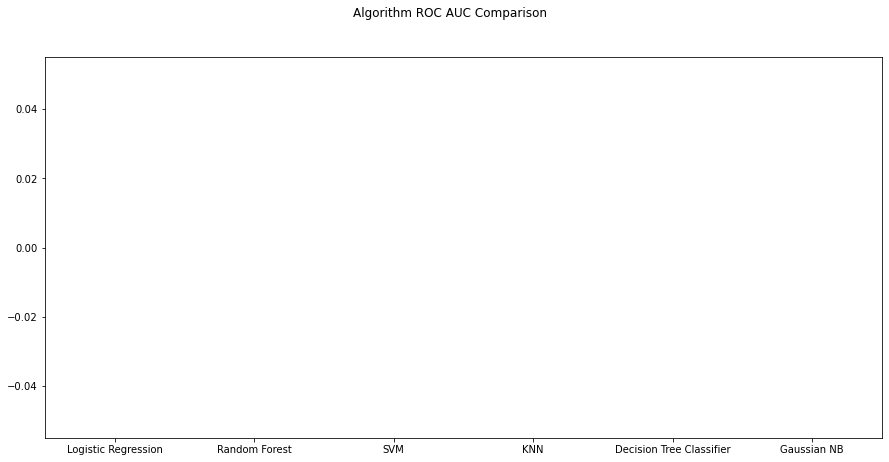

In [72]:
#Area under ROC Curve (or AUC for short) is a performance metric for binary classification problems. 
#The AUC represents a model’s ability to discriminate between positive and negative classes. An area of 1.0 represents a model that made all predictions perfectly. An area of 0.5 represents a model as good as random.

fig = plt.figure(figsize=(15, 7))
fig.suptitle('Algorithm ROC AUC Comparison')
ax = fig.add_subplot(111)
plt.boxplot(auc_results)
ax.set_xticklabels(names)
plt.show()

In [73]:
#Based on our ROC AUC comparison analysis, Logistic Regression and Random Forest show the highest mean AUC scores. We will shortlist these two algorithms for further analysis. See below for more details on these two algos.

#Logistic Regression is a Machine Learning classification algorithm that is used to predict the probability of a categorical dependent variable. Logistic Regression is classification algorithm that is not as sophisticated as the ensemble methods or boosted decision trees method discussed below. Hence, it provides us with a good benchmark. Random Forest is a popular and versatile machine learning method that is capable of solving both regression and classification. Random Forest is a brand of Ensemble learning, as it relies on an ensemble of decision trees. It aggregates Classification (or Regression) Trees. A decision tree is composed of a series of decisions that can be used to classify an observation in a dataset. 
# Random Forest fits a number of decision tree classifiers on various sub-samples of the dataset and use averaging to improve the predictive accuracy and control over-fitting. Random Forest can handle a large number of features, and is helpful for estimating which of your variables are important in the underlying data being modeled.

In [74]:
#Logistic Regression
#Let's take a closer look at using the Logistic Regression algorithm. I'll be using 10 fold Cross-Validation to train our Logistic Regression Model and estimate its AUC score.

kfold = model_selection.KFold(n_splits=10, random_state=7)
modelCV = LogisticRegression(solver='liblinear',
                             class_weight="balanced", 
                             random_state=7)
scoring = 'roc_auc'
results = model_selection.cross_val_score(
    modelCV, X_train, y_train, cv=kfold, scoring=scoring)
print("AUC score (STD): %.2f (%.2f)" % (results.mean(), results.std()))

C:\Users\Hp\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\model_selection\_split.py:293: FutureWarning:

Setting a random_state has no effect since shuffle is False. This will raise an error in 0.24. You should leave random_state to its default (None), or set shuffle=True.

C:\Users\Hp\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\model_selection\_validation.py:548: FitFailedWarning:

Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\Hp\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\model_selection\_validation.py", line 531, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\Hp\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\linear_model\_logistic.py", line 1342, in fit
    X, y = self._validate_data(X, y, accept_sparse='csr', dtype=_dtype,
  File "C:\Users\Hp\AppData\

In [75]:
#Fine-tuning
#GridSearchCV allows use to fine-tune hyper-parameters by searching over specified parameter values for an estimator.

param_grid = {'C': np.arange(1e-03, 2, 0.01)} # hyper-parameter list to fine-tune
log_gs = GridSearchCV(LogisticRegression(solver='liblinear', # setting GridSearchCV
                                         class_weight="balanced", 
                                         random_state=7),
                      iid=True,
                      return_train_score=True,
                      param_grid=param_grid,
                      scoring='roc_auc',
                      cv=10)

log_grid = log_gs.fit(X_train, y_train)
log_opt = log_grid.best_estimator_
results = log_gs.cv_results_

print('='*20)
print("best params: " + str(log_gs.best_estimator_))
print("best params: " + str(log_gs.best_params_))
print('best score:', log_gs.best_score_)
print('='*20)

thon\Python38\lib\site-packages\sklearn\utils\validation.py", line 73, in inner_f
    return f(**kwargs)
  File "C:\Users\Hp\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\utils\validation.py", line 599, in check_array
    array = np.asarray(array, order=order, dtype=dtype)
  File "C:\Users\Hp\AppData\Local\Programs\Python\Python38\lib\site-packages\numpy\core\_asarray.py", line 83, in asarray
    return array(a, dtype, copy=False, order=order)
ValueError: could not convert string to float: 'Apcnt_999996'


C:\Users\Hp\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\model_selection\_validation.py:548: FitFailedWarning:

Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\Hp\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\model_selection\_validation.py", line 531, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_pa

ValueError: could not convert string to float: 'Apcnt_999996'

In [ ]:
#As shown above, the results from GridSearchCV provided us with fine-tuned hyper-parameter using ROC_AUC as the scoring metric.

#Evaluation

## Confusion Matrix
cnf_matrix = metrics.confusion_matrix(y_test, log_opt.predict(X_test))
class_names=[0,1] # name  of classes
fig, ax = plt.subplots()
tick_marks = np.arange(len(class_names))
plt.xticks(tick_marks, class_names)
plt.yticks(tick_marks, class_names)
# create heatmap
sns.heatmap(pd.DataFrame(cnf_matrix), annot=True, cmap="YlGnBu" ,fmt='g')
ax.xaxis.set_label_position("top")
plt.tight_layout()
plt.title('Confusion matrix', y=1.1)
plt.ylabel('Actual label')
plt.xlabel('Predicted label')

In [ ]:
print('Accuracy of Logistic Regression Classifier on test set: {:.2f}'.format(log_opt.score(X_test, y_test)*100))

In [ ]:
# Classification report for the optimised Log Regression
log_opt.fit(X_train, y_train)
print(classification_report(y_test, log_opt.predict(X_test)))

In [ ]:
log_opt.fit(X_train, y_train) # fit optimised model to the training data
probs = log_opt.predict_proba(X_test) # predict probabilities
probs = probs[:, 1] # we will only keep probabilities associated with the employee leaving
logit_roc_auc = roc_auc_score(y_test, probs) # calculate AUC score using test dataset
print('AUC score: %.3f' % logit_roc_auc)

In [ ]:
#Random Forest Classifier
#Let's take a closer look at using the Random Forest algorithm. I'll fine-tune the Random Forest algorithm's hyper-parameters by cross-validation against the AUC score.

#Fine-tuning

rf_classifier = RandomForestClassifier(class_weight = "balanced",
                                       random_state=7)
param_grid = {'n_estimators': [50, 75, 100, 125, 150, 175],
              'min_samples_split':[2,4,6,8,10],
              'min_samples_leaf': [1, 2, 3, 4],
              'max_depth': [5, 10, 15, 20, 25]}

grid_obj = GridSearchCV(rf_classifier,
                        iid=True,
                        return_train_score=True,
                        param_grid=param_grid,
                        scoring='roc_auc',
                        cv=10)

grid_fit = grid_obj.fit(X_train, y_train)
rf_opt = grid_fit.best_estimator_

print('='*20)
print("best params: " + str(grid_obj.best_estimator_))
print("best params: " + str(grid_obj.best_params_))
print('best score:', grid_obj.best_score_)
print('='*20)



In [ ]:
#Random Forest allows us to know which features are of the most importance in predicting the target feature ("attrition" in this project). Below, we plot features by their importance.

importances = rf_opt.feature_importances_
indices = np.argsort(importances)[::-1] # Sort feature importances in descending order
names = [X_train.columns[i] for i in indices] # Rearrange feature names so they match the sorted feature importances
plt.figure(figsize=(15, 7)) # Create plot
plt.title("Feature Importance") # Create plot title
plt.bar(range(X_train.shape[1]), importances[indices]) # Add bars
plt.xticks(range(X_train.shape[1]), names, rotation=90) # Add feature names as x-axis labels
plt.show() # Show plot
#Random Forest helped us identify the Top 10 most important indicators (ranked in the table below) as: (give the list here)

importances = rf_opt.feature_importances_
df_param_coeff = pd.DataFrame(columns=['Feature', 'Coefficient'])
for i in range(44):
    feat = X_train.columns[i]
    coeff = importances[i]
    df_param_coeff.loc[i] = (feat, coeff)
df_param_coeff.sort_values(by='Coefficient', ascending=False, inplace=True)
df_param_coeff = df_param_coeff.reset_index(drop=True)
df_param_coeff.head(10)

In [ ]:
#Evaluation

## Confusion Matrix
cnf_matrix = metrics.confusion_matrix(y_test, rf_opt.predict(X_test))
class_names=[0,1] # name  of classes
fig, ax = plt.subplots()
tick_marks = np.arange(len(class_names))
plt.xticks(tick_marks, class_names)
plt.yticks(tick_marks, class_names)
# create heatmap
sns.heatmap(pd.DataFrame(cnf_matrix), annot=True, cmap="YlGnBu" ,fmt='g')
ax.xaxis.set_label_position("top")
plt.tight_layout()
plt.title('Confusion matrix', y=1.1)
plt.ylabel('Actual label')
plt.xlabel('Predicted label')

#Risk Category
#As the company generates more data on its employees (on New Joiners and recent Leavers) the algorithm can be re-trained using the additional data and theoritically generate more accurate predictions to identify high-risk employees of leaving based on the probabilistic label assigned to each feature variable (i.e. employee) by the algorithm.

#Employees can be assigning a "Risk Category" based on the predicted label such that:

#Low-risk for employees with label < 0.6
#Medium-risk
print('Accuracy of RandomForest Regression Classifier on test set: {:.2f}'.format(rf_opt.score(X_test, y_test)*100))

In [ ]:
# Classification report for the optimised RF Regression
rf_opt.fit(X_train, y_train)
print(classification_report(y_test, rf_opt.predict(X_test)))
#Using probabilistic class prediction resulted in AUC score is: 0.818 which is higher than that best score during the optimisation step.


rf_opt.fit(X_train, y_train) # fit optimised model to the training data
probs = rf_opt.predict_proba(X_test) # predict probabilities
probs = probs[:, 1] # we will only keep probabilities associated with the employee leaving
rf_opt_roc_auc = roc_auc_score(y_test, probs) # calculate AUC score using test dataset
print('AUC score: %.3f' % rf_opt_roc_auc)

In [ ]:
#ROC Graphs
#AUC - ROC curve is a performance measurement for classification problem at various thresholds settings. ROC is a probability curve and AUC represents degree or measure of separability. It tells how much model is capable of distinguishing between classes. The green line represents the ROC curve of a purely random classifier; a good classifier stays as far away from that line as possible (toward the top-left corner).

# Create ROC Graph
from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(y_test, log_opt.predict_proba(X_test)[:,1])
rf_fpr, rf_tpr, rf_thresholds = roc_curve(y_test, rf_opt.predict_proba(X_test)[:,1])
plt.figure(figsize=(14, 6))

# Plot Logistic Regression ROC
plt.plot(fpr, tpr, label='Logistic Regression (area = %0.2f)' % logit_roc_auc)
# Plot Random Forest ROC
plt.plot(rf_fpr, rf_tpr, label='Random Forest (area = %0.2f)' % rf_opt_roc_auc)
# Plot Base Rate ROC
plt.plot([0,1], [0,1],label='Base Rate' 'k--')

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Graph')
plt.legend(loc="lower right")
plt.show()

#As shown below, the fine-tuned Logistic Regression model showed a higher AUC score compared to the Random Forest Classifier.



In [ ]:
#Concluding Remarks
#Risk Category
#As the company generates more data on its employees (on New Joiners and recent Leavers) the algorithm can be re-trained using the additional data and theoritically generate more accurate predictions to identify high-risk employees of leaving based on the probabilistic label assigned to each feature variable (i.e. employee) by the algorithm.

#Employees can be assigning a "Risk Category" based on the predicted label such that:

#Low-risk for employees with label < 0.6
#Medium-risk for employees with label between 0.6 and 0.8
#High-risk for employees with label > 0.8 

#Strategic Retention Plan